## **Machine Learning:**

#### - How do you learn?
#### - What is the common sense about ML?

In [100]:
using Pkg

In [101]:
Pkg.add("CSV")
Pkg.add("DataFrames")
Pkg.add("Statistics")

In [102]:
using CSV
using DataFrames
using Plots
using Statistics

In [103]:
df = CSV.read("../datasets/logP.csv", DataFrame, header=["Molecule", "logP"])

Row,Molecule,logP
,String,Float64
1,C[C@H]([C@@H](C)Cl)Cl,2.3
2,C(C=CBr)N,0.3
3,CCC(CO)Br,1.3
4,[13CH3][13CH2][13CH2][13CH2][13CH2][13CH2]O,2.0
5,CCCOCCP,0.6
6,C(C(F)(F)F)F,1.7
7,[2H]C([2H])C(C)(C)Cl,1.8
8,CCCC(CI)O,2.0
9,CCCCCC[CH+]C,3.9


In [104]:
df[:, :logP]

14610-element Vector{Float64}:
  2.3
  0.3
  1.3
  2.0
  0.6
  1.7
  1.8
  2.0
  3.9
 -1.4
  ⋮
  1.0
  1.0
  1.5
  0.9
  2.7
 -1.8
  0.4
  3.4
  1.0

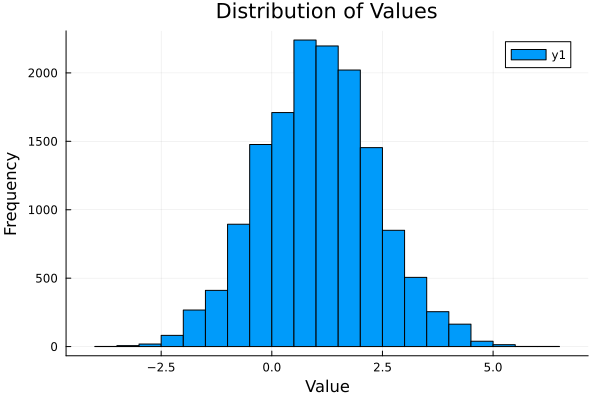

In [105]:
histogram(df[:, :logP], bins=20, xlabel="Value", ylabel="Frequency", title="Distribution of Values")

In [106]:
mean_value = mean(df[:, :logP])

0.9986652977412731

In [107]:
median_value = median(df[:, :logP])

1.0

In [108]:
std_dev = std(df[:, :logP])

1.3004862787101674

### Descriptors

In [109]:
train = CSV.read("../datasets/train.csv", DataFrame, header=["num_of_atoms","num_of_heavy_atoms","num_of_C_atoms","num_of_O_atoms","num_of_N_atoms","num_of_Cl_atoms","tpsa","mol_w","num_valence_electrons","num_heteroatoms"])

Row,num_of_atoms,num_of_heavy_atoms,num_of_C_atoms,num_of_O_atoms,num_of_N_atoms,num_of_Cl_atoms,tpsa,mol_w,num_valence_electrons,num_heteroatoms
,Int64,Int64,Int64,Int64,Int64,Int64,Float64,Float64,Int64,Int64
1,14,6,4,0,0,2,0.0,126.0,38,2
2,11,5,3,0,1,0,26.02,134.968,30,2
3,15,6,4,1,0,0,20.23,151.984,38,2
4,21,7,6,1,0,0,20.23,108.125,44,1
5,20,7,5,1,0,0,9.23,120.07,44,2
6,8,6,2,0,0,0,0.0,102.009,38,4
7,14,5,4,0,0,1,0.0,94.0518,32,1
8,18,7,5,1,0,0,20.23,213.985,44,2
9,25,8,8,0,0,0,0.0,113.132,48,0


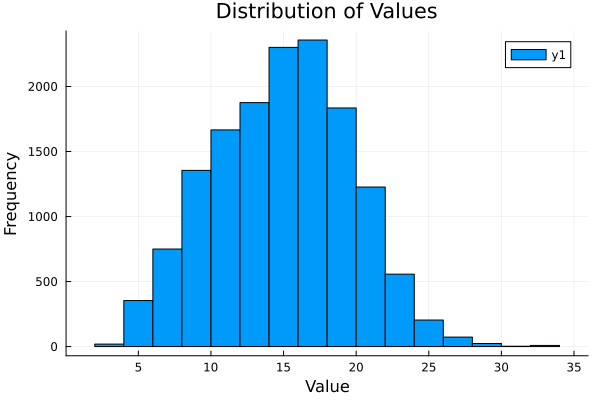

In [110]:
histogram(train[:, :num_of_atoms], bins=20, xlabel="Value", ylabel="Frequency", title="Distribution of Values")

In [111]:
using Pkg
Pkg.add("MLJ")

In [112]:
using CSV, DataFrames, MLJ

In [113]:
res = df[:, :logP]

14610-element Vector{Float64}:
  2.3
  0.3
  1.3
  2.0
  0.6
  1.7
  1.8
  2.0
  3.9
 -1.4
  ⋮
  1.0
  1.0
  1.5
  0.9
  2.7
 -1.8
  0.4
  3.4
  1.0

In [114]:
X = train[:, 1:end-1] # Input features (independent variables)

Row,num_of_atoms,num_of_heavy_atoms,num_of_C_atoms,num_of_O_atoms,num_of_N_atoms,num_of_Cl_atoms,tpsa,mol_w,num_valence_electrons
,Int64,Int64,Int64,Int64,Int64,Int64,Float64,Float64,Int64
1,14,6,4,0,0,2,0.0,126.0,38
2,11,5,3,0,1,0,26.02,134.968,30
3,15,6,4,1,0,0,20.23,151.984,38
4,21,7,6,1,0,0,20.23,108.125,44
5,20,7,5,1,0,0,9.23,120.07,44
6,8,6,2,0,0,0,0.0,102.009,38
7,14,5,4,0,0,1,0.0,94.0518,32
8,18,7,5,1,0,0,20.23,213.985,44
9,25,8,8,0,0,0,0.0,113.132,48


In [115]:
y = res[:, end]    # Target variable (dependent variable)

14610-element Vector{Float64}:
  2.3
  0.3
  1.3
  2.0
  0.6
  1.7
  1.8
  2.0
  3.9
 -1.4
  ⋮
  1.0
  1.0
  1.5
  0.9
  2.7
 -1.8
  0.4
  3.4
  1.0

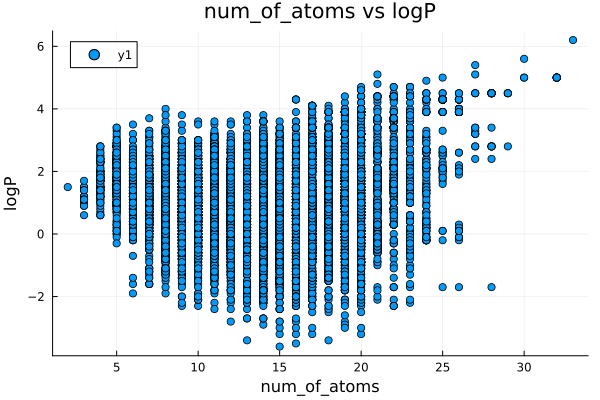

In [116]:
scatter(X[:, :num_of_atoms], y, xlabel="num_of_atoms", ylabel="logP", title="num_of_atoms vs logP")

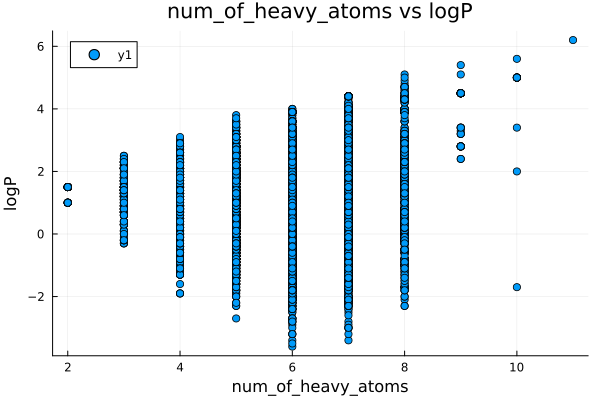

In [117]:
scatter(X[:, :num_of_heavy_atoms], y, xlabel="num_of_heavy_atoms", ylabel="logP", title="num_of_heavy_atoms vs logP")

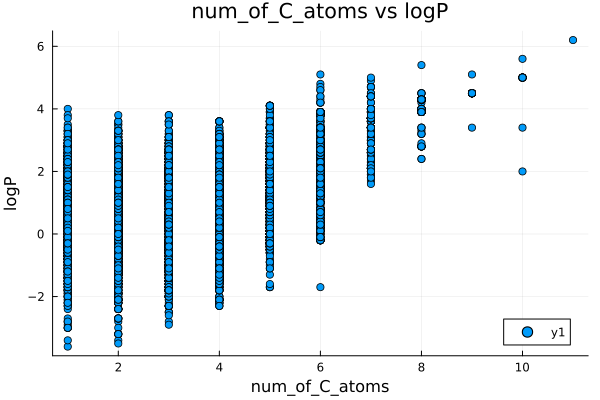

In [118]:
scatter(X[:, :num_of_C_atoms], y, xlabel="num_of_C_atoms", ylabel="logP", title="num_of_C_atoms vs logP")

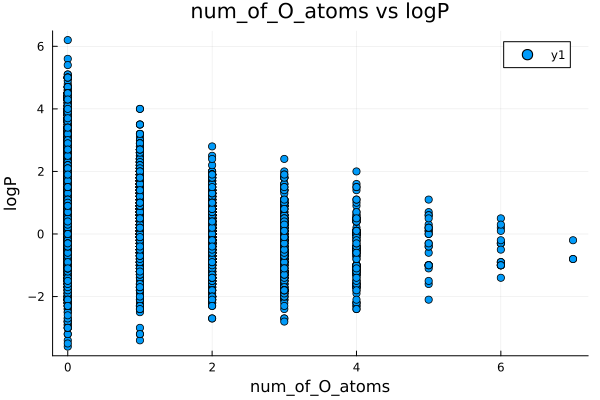

In [119]:
scatter(X[:, :num_of_O_atoms], y, xlabel="num_of_O_atoms", ylabel="logP", title="num_of_O_atoms vs logP")

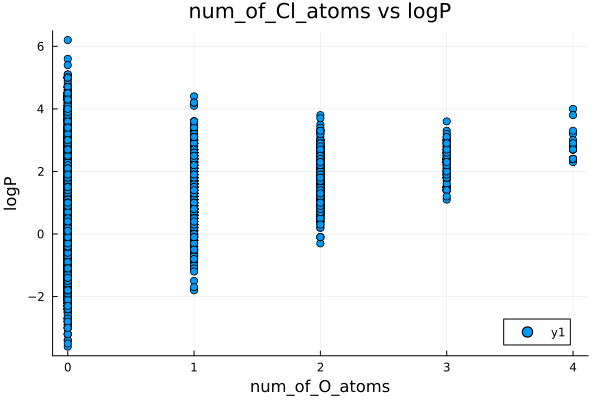

In [120]:
scatter(X[:, :num_of_Cl_atoms], y, xlabel="num_of_O_atoms", ylabel="logP", title="num_of_Cl_atoms vs logP")

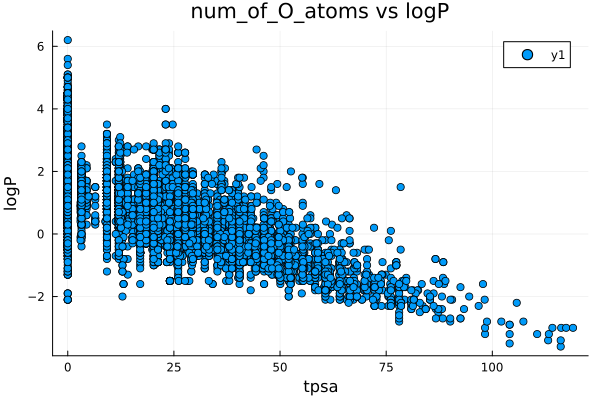

In [121]:
scatter(X[:, :tpsa], y, xlabel="tpsa", ylabel="logP", title="num_of_O_atoms vs logP")

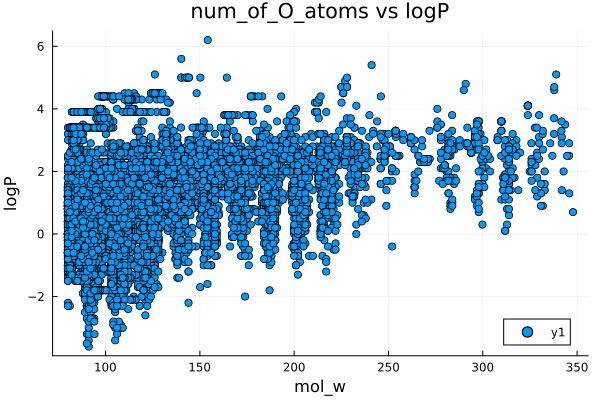

In [122]:
scatter(X[:, :mol_w], y, xlabel="mol_w", ylabel="logP", title="num_of_O_atoms vs logP")

### Linear Models

In [145]:
using GLM

In [149]:
size(X)

(14610, 9)

In [155]:
size(y)[1] * 0.8

11688.0

In [171]:
train = hcat(X[1:11688, :], df[1:11688, :logP]) 
test = hcat(X[11689:end, :], df[11689:end, :logP])

Row,num_of_atoms,num_of_heavy_atoms,num_of_C_atoms,num_of_O_atoms,num_of_N_atoms,num_of_Cl_atoms,tpsa,mol_w,num_valence_electrons,x1
,Int64,Int64,Int64,Int64,Int64,Int64,Float64,Float64,Int64,Float64
1,10,5,2,0,0,0,0.0,171.902,32,1.7
2,16,6,4,0,1,0,26.02,151.0,38,0.8
3,14,6,4,0,0,0,0.0,94.0594,38,1.8
4,6,5,2,0,2,0,24.72,84.9855,24,0.4
5,13,5,3,0,0,0,0.0,108.007,32,1.8
6,8,6,2,0,0,0,0.0,100.013,38,1.7
7,11,5,2,2,0,0,20.53,93.01,30,-0.4
8,24,8,6,0,2,0,24.06,116.131,50,1.3
9,12,5,4,0,0,0,0.0,87.0268,29,1.7


In [174]:
fm = @formula(x1 ~ num_of_atoms)
linearRegressor = lm(fm, train)

StatsModels.TableRegressionModel{LinearModel{GLM.LmResp{Vector{Float64}}, GLM.DensePredChol{Float64, LinearAlgebra.CholeskyPivoted{Float64, Matrix{Float64}, Vector{Int64}}}}, Matrix{Float64}}

x1 ~ 1 + num_of_atoms

Coefficients:
─────────────────────────────────────────────────────────────────────────
                 Coef.  Std. Error      t  Pr(>|t|)  Lower 95%  Upper 95%
─────────────────────────────────────────────────────────────────────────
(Intercept)   0.599435   0.0387304  15.48    <1e-52  0.523517   0.675353
num_of_atoms  0.027243   0.0025546  10.66    <1e-25  0.0222355  0.0322504
─────────────────────────────────────────────────────────────────────────

In [175]:
r2(linearRegressor)

0.00963809715158892

In [182]:
fm = @formula(x1 ~ tpsa)
linearRegressor = lm(fm, train)

StatsModels.TableRegressionModel{LinearModel{GLM.LmResp{Vector{Float64}}, GLM.DensePredChol{Float64, LinearAlgebra.CholeskyPivoted{Float64, Matrix{Float64}, Vector{Int64}}}}, Matrix{Float64}}

x1 ~ 1 + tpsa

Coefficients:
──────────────────────────────────────────────────────────────────────────────
                  Coef.  Std. Error        t  Pr(>|t|)   Lower 95%   Upper 95%
──────────────────────────────────────────────────────────────────────────────
(Intercept)   1.94914    0.0106817    182.48    <1e-99   1.9282      1.97008
tpsa         -0.0527694  0.00040822  -129.27    <1e-99  -0.0535695  -0.0519692
──────────────────────────────────────────────────────────────────────────────

In [178]:
r2(linearRegressor)

0.5884627636067365

In [185]:
ytest_predicted = GLM.predict(linearRegressor, test)

2922-element Vector{Union{Missing, Float64}}:
  1.9491416792526726
  0.576083001804833
  1.9491416792526726
  0.6446831663199056
  1.9491416792526726
  1.9491416792526726
  0.8657867734877167
  0.6795109421506349
  1.9491416792526726
  1.3143263107016536
  ⋮
  0.9750193431386402
  0.8816175806835028
  1.3143263107016536
  1.20509374105073
  1.9491416792526726
 -1.2534306164548366
  0.6795109421506349
  1.9491416792526726
  1.4620805111956563

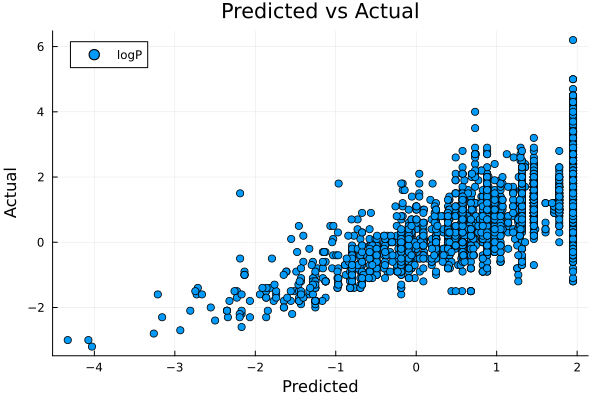

In [187]:
plot(ytest_predicted, test[:, :x1], seriestype=:scatter, xlabel="Predicted", ylabel="Actual", title="Predicted vs Actual", label="logP")

In [188]:
fm = @formula(x1 ~ num_of_atoms + num_of_heavy_atoms + num_of_C_atoms + num_of_O_atoms + num_of_N_atoms + num_of_Cl_atoms + tpsa + mol_w + num_valence_electrons + tpsa)
linearRegressor = lm(fm, train)

StatsModels.TableRegressionModel{LinearModel{GLM.LmResp{Vector{Float64}}, GLM.DensePredChol{Float64, LinearAlgebra.CholeskyPivoted{Float64, Matrix{Float64}, Vector{Int64}}}}, Matrix{Float64}}

x1 ~ 1 + num_of_atoms + num_of_heavy_atoms + num_of_C_atoms + num_of_O_atoms + num_of_N_atoms + num_of_Cl_atoms + tpsa + mol_w + num_valence_electrons

Coefficients:
───────────────────────────────────────────────────────────────────────────────────────────
                             Coef.   Std. Error       t  Pr(>|t|)    Lower 95%    Upper 95%
───────────────────────────────────────────────────────────────────────────────────────────
(Intercept)             0.11077     0.0379233      2.92    0.0035   0.0364343    0.185106
num_of_atoms           -0.303154    0.00625071   -48.50    <1e-99  -0.315406    -0.290901
num_of_heavy_atoms     -1.42843     0.0396699    -36.01    <1e-99  -1.50619     -1.35067
num_of_C_atoms          0.925194    0.014243      64.96    <1e-99   0.897276     0.953113
num_of

In [190]:
r2(linearRegressor)

0.7763538655399215

In [191]:
y_test_predicted = GLM.predict(linearRegressor, test)

2922-element Vector{Union{Missing, Float64}}:
  1.6465470400417574
  1.073353238805538
  2.151754949647339
 -0.3999326237891063
  1.3414458416415194
  2.1501824393640767
 -0.3855861947102408
  1.0471255700555115
  1.6210792654964443
  1.022079573051423
  ⋮
  1.2920057452810614
  0.8766160797594367
  0.7933569184682714
  1.5114389874523741
  2.2196819602190967
 -0.9604850128025468
  0.3583010388671344
  2.1942141856737836
  1.1827361030847552

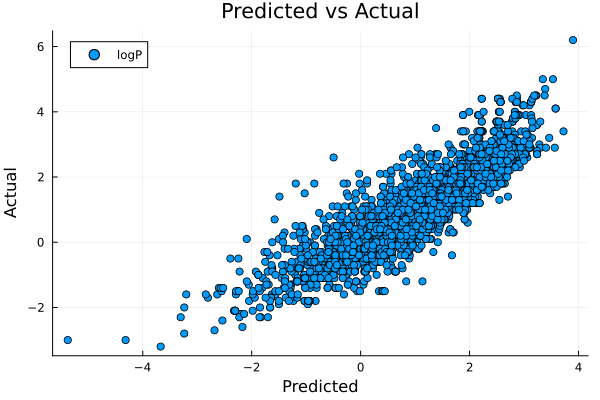

In [192]:
plot(y_test_predicted, test[:, :x1], seriestype=:scatter, xlabel="Predicted", ylabel="Actual", title="Predicted vs Actual", label="logP")

## Evaluating performance

In [198]:
performance_testdf = DataFrame(y_actual = test[!,:x1], y_predicted = y_test_predicted)

Row,y_actual,y_predicted
,Float64,Float64?
1,1.7,1.64655
2,0.8,1.07335
3,1.8,2.15175
4,0.4,-0.399933
5,1.8,1.34145
6,1.7,2.15018
7,-0.4,-0.385586
8,1.3,1.04713
9,1.7,1.62108


In [199]:
performance_testdf.error = performance_testdf[!,:y_actual] - performance_testdf[!,:y_predicted]
performance_testdf.error_sq = performance_testdf.error.*performance_testdf.error

2922-element Vector{Float64}:
 0.002857218928297477
 0.07472199316547747
 0.12373154460140191
 0.639892202602124
 0.21027191614785457
 0.20266422871179066
 0.00020775778293109082
 0.06394547731975002
 0.006228482334580717
 0.014903422156417705
 ⋮
 0.0852673552771481
 0.015223591773929693
 0.49934444467665723
 0.3738576353767845
 0.23070541933896957
 0.70478541372914
 0.0017388033595602394
 1.4539194300303366
 0.03339248337060227

In [201]:
function rmse(performance_df)
    rmse = sqrt(mean(performance_df.error.*performance_df.error))
    return rmse
end

rmse (generic function with 1 method)

In [204]:
rmse_test = rmse(performance_testdf)

0.6287072674120345

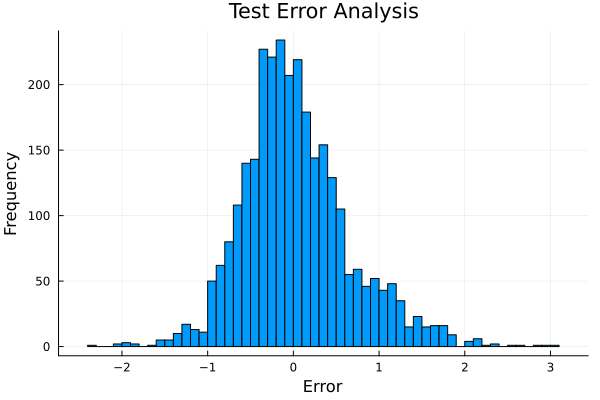

In [206]:
histogram(performance_testdf.error, bins = 50, title = "Test Error Analysis", ylabel = "Frequency", xlabel = "Error",legend = false)